In [1]:
from PIL import Image
import imageio
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2
from scipy import ndimage as ndi
from skimage import feature
from skimage.color import rgb2gray
%matplotlib inline

## Read image with imageio

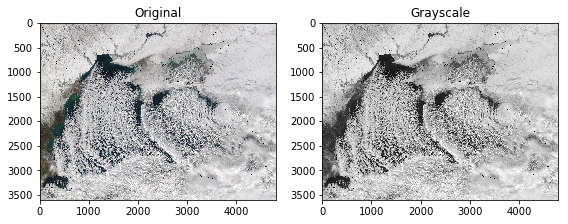

In [2]:
pic = imageio.imread('blacksea_amo_2015008_lrg.jpg')
gray = rgb2gray(pic)
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()
ax[0].imshow(pic)
ax[0].set_title("Original")
ax[1].imshow(gray, cmap=plt.cm.gray)
ax[1].set_title("Grayscale")
fig.tight_layout()
plt.show()

In [3]:
print('Original image')
print('Shape of the image : {}'.format(pic.shape))
print('Image Hight {}'.format(pic.shape[0]))
print('Image Width {}'.format(pic.shape[1]))
print('Dimension of Image {}'.format(pic.ndim))
print()
print()

print('Grayscale image')
print('Shape of the image : {}'.format(gray.shape))
print('Image Hight {}'.format(gray.shape[0]))
print('Image Width {}'.format(gray.shape[1]))
print('Dimension of Image {}'.format(gray.ndim))

Original image
Shape of the image : (3600, 4800, 3)
Image Hight 3600
Image Width 4800
Dimension of Image 3


Grayscale image
Shape of the image : (3600, 4800)
Image Hight 3600
Image Width 4800
Dimension of Image 2


## Open image with PIL 

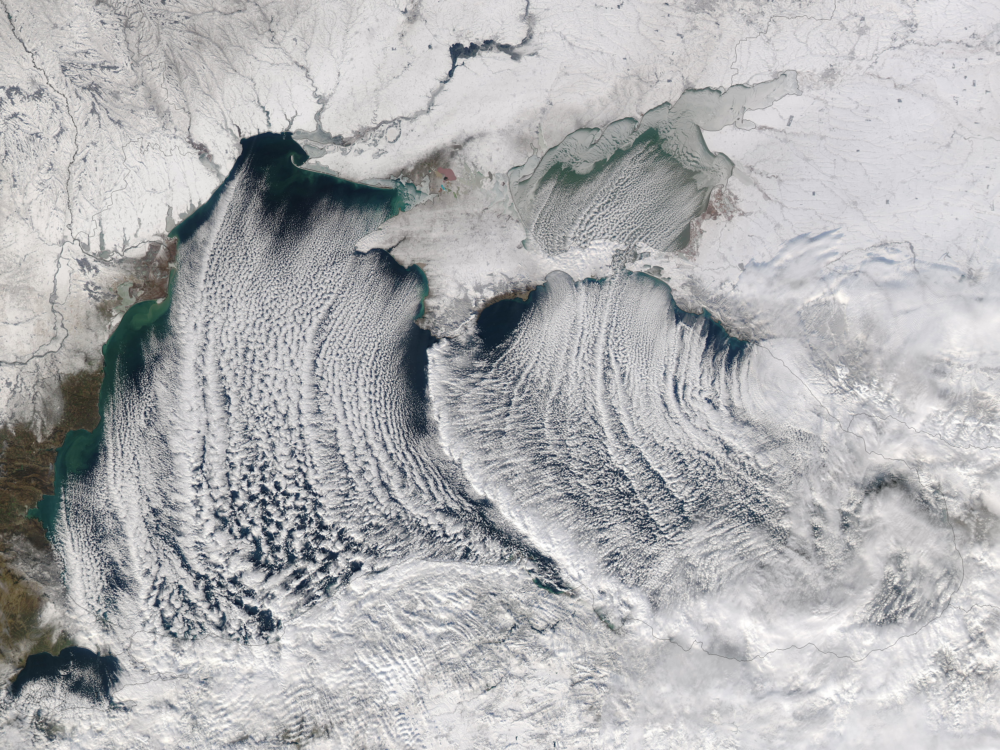

In [4]:
im = Image.open('blacksea_amo_2015008_lrg.jpg')
im

## Scipy cluster detection

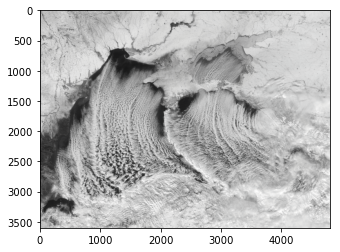

In [5]:
n=5
l=256
im2 = ndi.gaussian_filter(im, sigma=l/(8.*n))  # blur the image a bit
plt.imshow(im2);

Number of clusters is 642


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


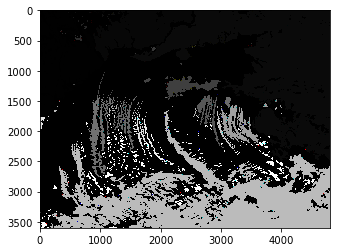

In [8]:
mask = im2 > im2.mean()+10     # mask those pixels whose intensity is above mean
label_im, nb_labels = ndi.label(mask)   # connected components form clusters
print(f"Number of clusters is {nb_labels}")
plt.imshow(label_im);

## Scipy canny detection

In [ ]:
data = list(im.getdata())
edges1 = feature.canny(gray)
edges2 = feature.canny(gray, sigma=3)

fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(8, 3),
                                    sharex=True, sharey=True)

ax1.imshow(im, cmap=plt.cm.gray)
ax1.axis('off')
ax1.set_title('noisy image', fontsize=20)

ax2.imshow(edges1, cmap=plt.cm.gray)
ax2.axis('off')
ax2.set_title(r'Canny filter, $\sigma=1$', fontsize=20)

ax3.imshow(edges2, cmap=plt.cm.gray)
ax3.axis('off')
ax3.set_title(r'Canny filter, $\sigma=3$', fontsize=20)

fig.tight_layout()

plt.show()

## Open with CV2 + Sobel Edge

In [ ]:
img = cv2.imread("blacksea_amo_2015008_lrg.jpg")
edge_img = cv2.Canny(img,100,200)
cv2.imshow("Detected Edges", edge_img)

In [ ]:
img0 = cv2.imread('blacksea_amo_2015008_lrg.jpg',)

# converting to gray scale
gray = cv2.cvtColor(img0, cv2.COLOR_BGR2GRAY)

# remove noise
img = cv2.GaussianBlur(gray,(3,3),0)

# convolute with proper kernels
laplacian = cv2.Laplacian(img,cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)  # x
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)  # y

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])

plt.show()

In [ ]:
from skimage import data
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt


def identity(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image


image = color.rgb2gray(data.retina())[300:700, 700:900]
cmap = plt.cm.gray

kwargs = {'sigmas': [1], 'mode': 'reflect'}

fig, axes = plt.subplots(2, 5)
for i, black_ridges in enumerate([1, 0]):
    for j, func in enumerate([identity, meijering, sato, frangi, hessian]):
        kwargs['black_ridges'] = black_ridges
        result = func(image, **kwargs)
        axes[i, j].imshow(result, cmap=cmap, aspect='auto')
        if i == 0:
            axes[i, j].set_title(['Original\nimage', 'Meijering\nneuriteness',
                                  'Sato\ntubeness', 'Frangi\nvesselness',
                                  'Hessian\nvesselness'][j])
        if j == 0:
            axes[i, j].set_ylabel('black_ridges = ' + str(bool(black_ridges)))
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()